In [1]:
import cv2

In [2]:
cv2.__version__

'4.4.0'

In [3]:
import numpy as np
import matplotlib.pyplot as plt

In [6]:
# Reading the Images
img_right = cv2.imread('./images/img2.jpg')

img_left = cv2.imread('./images/img1.jpg')

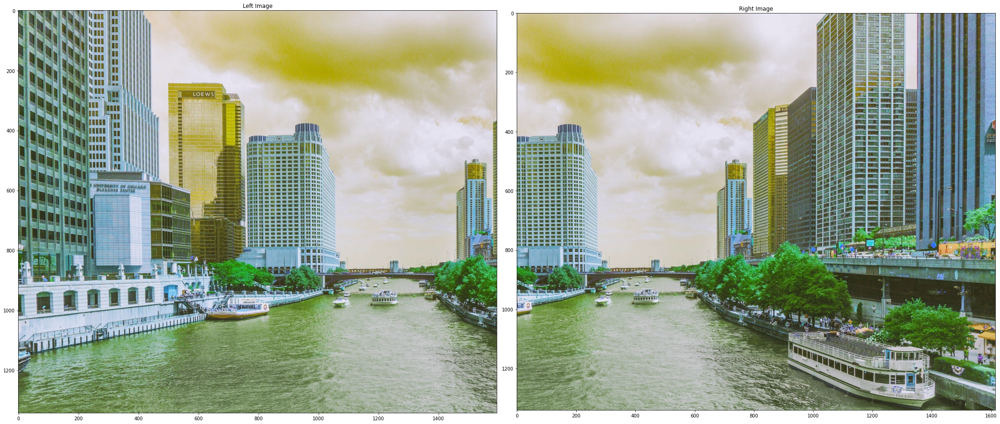

In [7]:
plt.figure(figsize=(30,20))

plt.subplot(1,2,1)
plt.title("Left Image")
plt.imshow(img_left)

plt.subplot(1,2,2)
plt.title("Right Image")
plt.imshow(img_right)


plt.tight_layout()

### BGR to RGB and Grayscale
By default, a color image with Red, Green, and Blue channels will be read in reverse order; ie, Blue, Green, and Red by OpenCv.

We could fix this issue by using cv2.COLOR_BGR2RGB transformation effect on the image.

So, we shall define a function fixColor to return the RGB form of the given image.

Also, let us get the gray-scle form of the two images. Generally, because of the reduced complexity of Grayscale form over the RGB format, grayscale images are preferred to process the images.

In [8]:
def fixColor(image):
    return(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

In [9]:
img1 = cv2.cvtColor(img_right, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img_left , cv2.COLOR_BGR2GRAY)

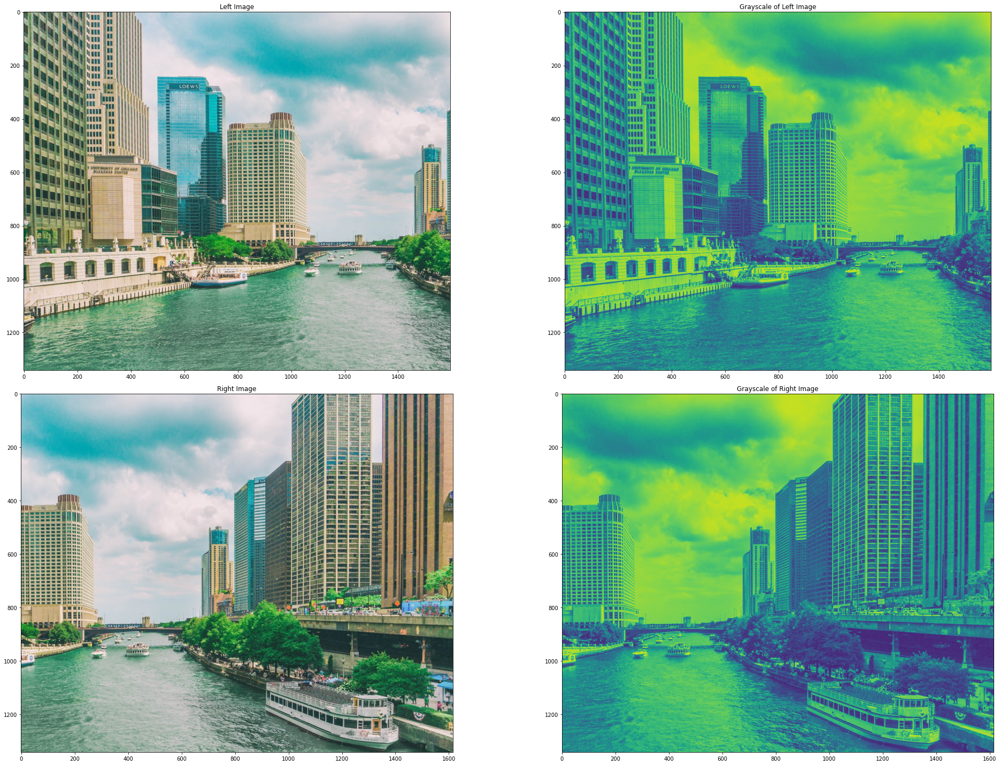

In [10]:
plt.figure(figsize=(30,20))

plt.subplot(2,2,1)
plt.title("Left Image")
plt.imshow(fixColor(img_left))

plt.subplot(2,2,2)
plt.title("Grayscale of Left Image")
plt.imshow(img2)

plt.subplot(2,2,3)
plt.title("Right Image")
plt.imshow(fixColor(img_right))

plt.subplot(2,2,4)
plt.title("Grayscale of Right Image")
plt.imshow(img1)

plt.tight_layout()

### Getting Key-Points and Feature Descriptors
In order to stitch two images, we should first find out the matching image features between both of them, so that we could stitch them based on these features.

Image features are small patches that are useful to compute similarities between images. An image feature is usually composed of a feature keypoint and a feature descriptor.

The key point usually contains the patch 2D position and other stuff if available such as scale and orientation of the image feature.

The descriptor contains the visual description of the patch and is used to compare the similarity between image features.

Let us use ORB algorithm from OpenCV to extract key-points and descriptors for each image. Though there are other alternatives to ORB - like SIFT and SURF - ORB wins over them as it is as efficient as them in computation-wise, performance-wise and ost importantly patent-wise. ORB is free while SIFT and SURF are patented.

In [11]:
orb = cv2.ORB_create()

In [12]:
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

### Visualizing Key-Points on the Images
Let us view the original image and the one with key-points marked to see what key-points were extracted.

In [13]:
img_right_kp = cv2.drawKeypoints(img_right, kp1, np.array([]), color=(0,0, 255))
img_left_kp = cv2.drawKeypoints(img_left, kp2, np.array([]), color=(0,0, 255))


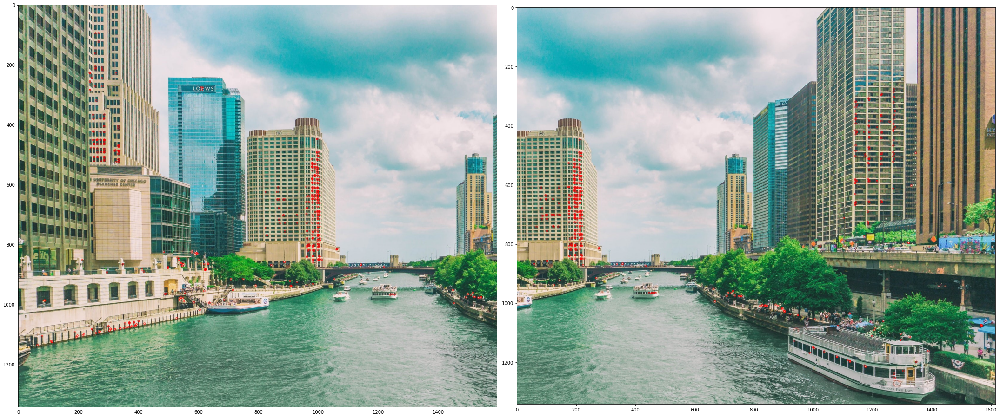

In [14]:
plt.figure(figsize=(30,20))
plt.subplot(1,2,1)
plt.imshow(fixColor(img_left_kp ))

plt.subplot(1,2,2)
plt.imshow(fixColor(img_right_kp ))
plt.tight_layout()

### Getting the Best Matches
The obtained descriptors in one image are to be recognized in the other image too. This is because, once the matching features are recognized, the images could be stitched based on these matching features.

In [15]:
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

In [16]:
matches = bf.match(des1,des2)

Matches is a list of DMatch objects. This DMatch object has the following attributes:

DMatch.distance - Distance between descriptors. The lower, the better it is.
DMatch.trainIdx - Index of the descriptor in train descriptors (des1)
DMatch.queryIdx - Index of the descriptor in query descriptors (des2)
DMatch.imgIdx - Index of the train image(right image)

In [17]:
matches

[<DMatch 000001DFC58829D0>,
 <DMatch 000001DFC569FDD0>,
 <DMatch 000001DFC569FE30>,
 <DMatch 000001DFC56C2770>,
 <DMatch 000001DFC56C27F0>,
 <DMatch 000001DFC56C2830>,
 <DMatch 000001DFC56C2810>,
 <DMatch 000001DFC56C2850>,
 <DMatch 000001DFC56C21F0>,
 <DMatch 000001DFC56C2410>,
 <DMatch 000001DFC56C2210>,
 <DMatch 000001DFC56C2250>,
 <DMatch 000001DFC56C2990>,
 <DMatch 000001DFC56C29F0>,
 <DMatch 000001DFC56C2450>,
 <DMatch 000001DFC56C29D0>,
 <DMatch 000001DFC56C2150>,
 <DMatch 000001DFC56C2A70>,
 <DMatch 000001DFC56C2A10>,
 <DMatch 000001DFC56C2AB0>,
 <DMatch 000001DFC56C2A90>,
 <DMatch 000001DFC56C2A50>,
 <DMatch 000001DFC56C2870>,
 <DMatch 000001DFC56C2890>,
 <DMatch 000001DFC56C2A30>,
 <DMatch 000001DFC56C23B0>,
 <DMatch 000001DFC56C2230>,
 <DMatch 000001DFC56C2270>,
 <DMatch 000001DFC56C2390>,
 <DMatch 000001DFC56C2AD0>,
 <DMatch 000001DFC56C2AF0>,
 <DMatch 000001DFC56C2B10>,
 <DMatch 000001DFC56C2B30>,
 <DMatch 000001DFC56C2B50>,
 <DMatch 000001DFC56C2B70>,
 <DMatch 000001DFC56

In [18]:
#Now, let us sort them in the order of their distances.
matches = sorted(matches, key = lambda x:x.distance)

In [19]:
matches

[<DMatch 000001DFC56C2AD0>,
 <DMatch 000001DFC56C2BD0>,
 <DMatch 000001DFC56C2D10>,
 <DMatch 000001DFC56C2E10>,
 <DMatch 000001DFC58829D0>,
 <DMatch 000001DFC56C27F0>,
 <DMatch 000001DFC56C2A10>,
 <DMatch 000001DFC56C2A50>,
 <DMatch 000001DFC56C2A30>,
 <DMatch 000001DFC56C2B30>,
 <DMatch 000001DFC56C2C10>,
 <DMatch 000001DFC56C2D30>,
 <DMatch 000001DFC56C2DF0>,
 <DMatch 000001DFC56C2F30>,
 <DMatch 000001DFC56C2FB0>,
 <DMatch 000001DFC57101D0>,
 <DMatch 000001DFC57103B0>,
 <DMatch 000001DFC5710450>,
 <DMatch 000001DFC5710BF0>,
 <DMatch 000001DFC56C21F0>,
 <DMatch 000001DFC56C2410>,
 <DMatch 000001DFC56C2B90>,
 <DMatch 000001DFC56C2CB0>,
 <DMatch 000001DFC56C2CD0>,
 <DMatch 000001DFC56C2D70>,
 <DMatch 000001DFC56C2E50>,
 <DMatch 000001DFC56C2E90>,
 <DMatch 000001DFC5710290>,
 <DMatch 000001DFC57103D0>,
 <DMatch 000001DFC5710470>,
 <DMatch 000001DFC5710490>,
 <DMatch 000001DFC57104B0>,
 <DMatch 000001DFC5710650>,
 <DMatch 000001DFC56C2810>,
 <DMatch 000001DFC56C2990>,
 <DMatch 000001DFC56

### Viewing the Best Matches

In [20]:
# draw matches in yellow color
draw_params = dict(matchColor = (255,255,0),flags = 2)


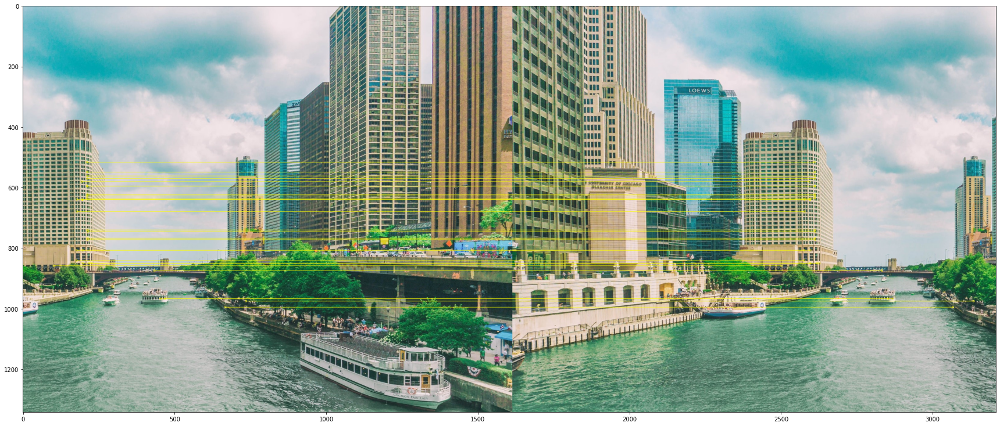

In [21]:
matched_features_image = cv2.drawMatches(fixColor(img_right), kp1, fixColor(img_left), kp2, matches[:30], None,**draw_params)

plt.figure(figsize=(30,20))
plt.imshow(matched_features_image)

### Finding Homography Matrix
It’s time to align the images now.

We need to align the images because, though both images could form a panorama, the two could differ in terms of angle, translation, size, etc, probably caused due to orientational difference in the camera while capturing the photos. Thus, we need to find a transformation matrix to perform this alignment, which ensures compatibility to stitch and form a panorama.

A Homography Matrix is a 3x3 transformation matrix that maps the points in one image to the corresponding points in the other image.

A homography matrix is used with the best matching points, to estimate a relative orientation transformation within the two images. Simply put, it is the perspective transformation matrix between two planes - here, the two images.

In order to find a homography matrix, at least 4 matching key-points are needed.

In [22]:
if len(matches) >= 4:
    src = np.float32([ kp1[m.queryIdx].pt for m in matches ]).reshape(-1,1,2)
    dst = np.float32([ kp2[m.trainIdx].pt for m in matches ]).reshape(-1,1,2)

    H, masked = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)
else:
    raise AssertionError("Can't find enough keypoints.")

### Image Registration
Now that we found the homography for transformation, we can now proceed to warp and display the right-side image in an orientation suitable to be stitched with the left image. This is also known as image registration.

In [23]:
dst = cv2.warpPerspective(img_right,H,(img_left.shape[1] + img_right.shape[1], img_left.shape[0]))

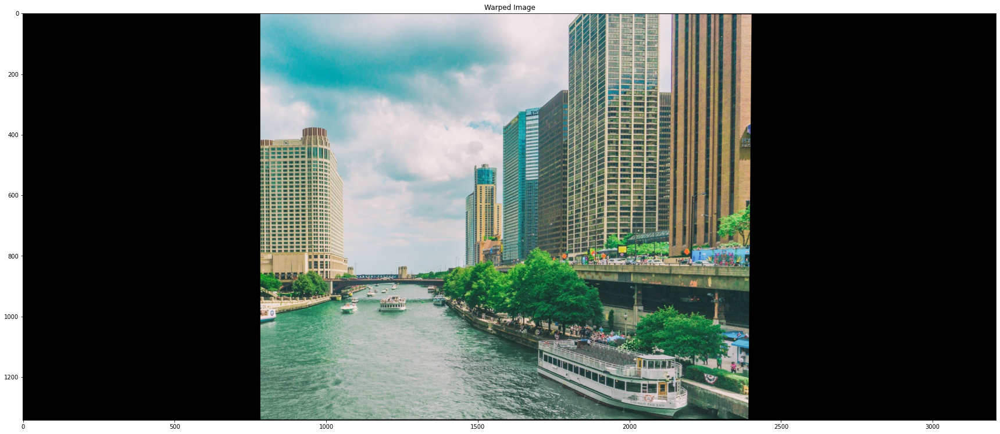

In [24]:
plt.figure(figsize=(30,20))
plt.title('Warped Image') 
plt.imshow(fixColor(dst))

### Stitching the Images

In [25]:
dst[0:img_left.shape[0], 0:img_left.shape[1]] = img_left

In [26]:
cv2.imwrite('resultant_stitched_panorama.jpg',dst)


True

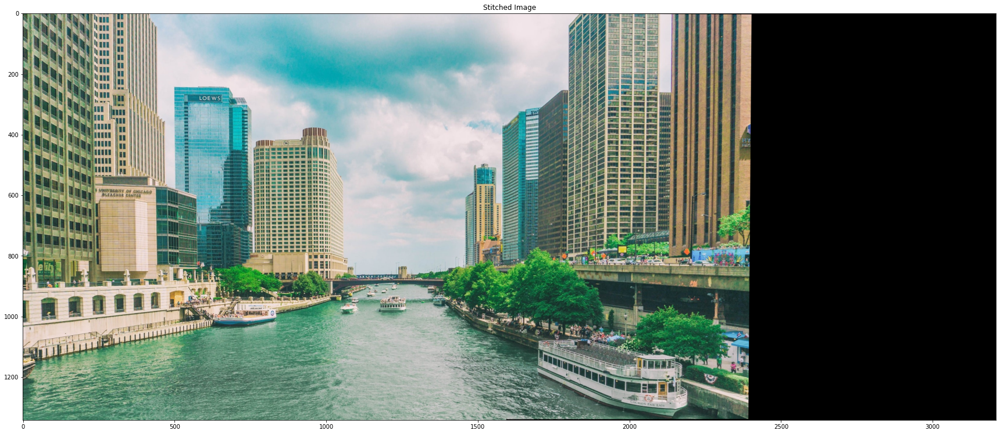

In [27]:
plt.figure(figsize=(30,20))
plt.title('Stitched Image')
plt.imshow(fixColor(dst))